In [1]:
import tensorflow as tf
import os
import pathlib
import time
import datetime
from matplotlib import pyplot as plt
from IPython import display
import cv2
from PIL import Image
import numpy as np
from tensorflow.keras import layers, models, optimizers

2024-07-08 20:29:15.697131: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-07-08 20:29:15.738315: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-08 20:29:15.738352: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-08 20:29:15.739434: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-07-08 20:29:15.745954: I tensorflow/core/platform/cpu_feature_guar

In [2]:
path_train = '/home/amirabbas/Documents/personal/university/8th/deep learning/NNDL_HW6/NNDL_HW6(1)/maps/train/'
path_val = '/home/amirabbas/Documents/personal/university/8th/deep learning/NNDL_HW6/NNDL_HW6(1)/maps/val/'

In [15]:
EPOCHS = 10
BATCH_SIZE = 2
BUFFER_SIZE = 400
LAMBDA = 100

generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

def load_image(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image)
    image = tf.image.resize(image, [256, 256 * 2],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

    w = tf.shape(image)[1]
    w = w // 2
    input_image = image[:, :w, :]
    real_image = image[:, w:, :]

    input_image = tf.cast(input_image, tf.float32)
    real_image = tf.cast(real_image, tf.float32)
    input_image = (input_image / 127.5) - 1
    real_image = (real_image / 127.5) - 1
    return input_image, real_image

def load_train_test_datasets(train_path, test_path):
    train_dataset = tf.data.Dataset.list_files(train_path + '*.jpg')
    train_dataset = train_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    train_dataset = train_dataset.shuffle(BUFFER_SIZE)
    train_dataset = train_dataset.batch(BATCH_SIZE)
    
    test_dataset = tf.data.Dataset.list_files(test_path + '*.jpg')
    test_dataset = test_dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    test_dataset = test_dataset.batch(BATCH_SIZE)
    
    return train_dataset, test_dataset


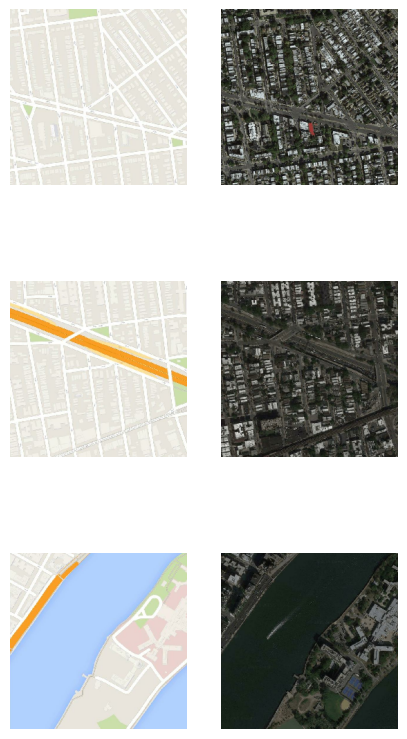

In [16]:
fig, axs = plt.subplots(3, 2, figsize=(5, 10))
for i in range(1, 4):
    real, result = load_image(path_train + f'/{i}.jpg')
    real, result = real.numpy(), result.numpy()
    axs[i-1][0].imshow(result)
    axs[i-1][1].imshow(real)
    axs[i-1][0].axis('off')  # Hide the axis
    axs[i-1][1].axis('off')  # Hide the axis
plt.savefig('mapsample')
plt.show()


In [5]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [6]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

# Generator

In [7]:
class Generator:  
  def __init__(self):
    inputs = tf.keras.layers.Input(shape=[256, 256, 3])

    down_stack = [
      downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
      downsample(128, 4),  # (batch_size, 64, 64, 128)
      downsample(256, 4),  # (batch_size, 32, 32, 256)
      downsample(512, 4),  # (batch_size, 16, 16, 512)
      downsample(512, 4),  # (batch_size, 8, 8, 512)
      downsample(512, 4),  # (batch_size, 4, 4, 512)
      downsample(512, 4),  # (batch_size, 2, 2, 512)
      downsample(512, 4),  # (batch_size, 1, 1, 512)
    ]

    up_stack = [
      upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
      upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
      upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
      upsample(512, 4),  # (batch_size, 16, 16, 1024)
      upsample(256, 4),  # (batch_size, 32, 32, 512)
      upsample(128, 4),  # (batch_size, 64, 64, 256)
      upsample(64, 4),  # (batch_size, 128, 128, 128)
    ]

    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(3, 4,
                                          strides=2,
                                          padding='same',
                                          kernel_initializer=initializer,
                                          activation='tanh')  # (batch_size, 256, 256, 3)
    x = inputs
    skips = []
    for down in down_stack:
      x = down(x)
      skips.append(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
      x = up(x)
      x = tf.keras.layers.Concatenate()([x, skip])

    x = last(x)

    self.model = tf.keras.Model(inputs=inputs, outputs=x)
  

generator = Generator().model


# Discriminator

In [8]:
class Discriminator:
    def __init__(self):
        initializer = tf.random_normal_initializer(0., 0.02)

        inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
        tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

        x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

        down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
        down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
        down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

        zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
        conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                        kernel_initializer=initializer,
                                        use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

        batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

        leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

        zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

        last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                        kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

        self.model = tf.keras.Model(inputs=[inp, tar], outputs=last)
discriminator = Discriminator().model

In [9]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

In [10]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

In [11]:
@tf.function
def train_step(input_image, target):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)
        
        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)
        
        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)
        
    generator_gradients = gen_tape.gradient(gen_total_loss, generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))
    
    return {
        "gen_total_loss": gen_total_loss,
        "gen_gan_loss": gen_gan_loss,
        "gen_l1_loss": gen_l1_loss,
        "disc_loss": disc_loss
    }


In [12]:
gen_total_losses = []
gen_gan_losses = []
gen_l1_losses = []
disc_losses = []

def generate_and_show_samples(generator, test_dataset):
    plt.figure(figsize=(15, 15))

    for i, (input_image, target) in enumerate(test_dataset.take(5)):
        prediction = generator(input_image, training=True)[0]
        
        # Plotting input image
        plt.subplot(5, 3, i*3 + 1)
        plt.imshow(input_image[0] * 0.5 + 0.5)
        plt.axis('off')
        if i == 0:
            plt.title('Input Image')
        
        # Plotting ground truth (target)
        plt.subplot(5, 3, i*3 + 2)
        plt.imshow(target[0] * 0.5 + 0.5)
        plt.axis('off')
        if i == 0:
            plt.title('Ground Truth')
        
        # Plotting generated image
        plt.subplot(5, 3, i*3 + 3)
        plt.imshow(prediction * 0.5 + 0.5)
        plt.axis('off')
        if i == 0:
            plt.title('Generated Image')
    plt.savefig('generated')
    plt.tight_layout()
    plt.show()

def fit(train_ds, test_ds, epochs, generator, discriminator):
    for epoch in range(epochs):
        start = time.time()
        
        for n, (input_image, target) in enumerate(train_ds):
            losses = train_step(input_image, target)
            
            if n % 100 == 0:
                print(f"Epoch {epoch+1} Batch {n} - "
                      f"Gen Total Loss: {losses['gen_total_loss'].numpy():.4f}, "
                      f"Disc Loss: {losses['disc_loss'].numpy():.4f}")
        
        # Display generated samples after each epoch
        print(f"Generated samples after epoch {epoch + 1}:")
        generate_and_show_samples(generator, test_ds)

        print(f"Time taken for epoch {epoch+1} is {time.time()-start:.4f} sec\n")
        avg_gen_total_loss = tf.reduce_mean([losses['gen_total_loss'].numpy()])
        avg_gen_gan_loss = tf.reduce_mean([losses['gen_gan_loss'].numpy()])
        avg_gen_l1_loss = tf.reduce_mean([losses['gen_l1_loss'].numpy()])
        avg_disc_loss = tf.reduce_mean([losses['disc_loss'].numpy()])

        # Append average losses to lists
        gen_total_losses.append(avg_gen_total_loss)
        gen_gan_losses.append(avg_gen_gan_loss)
        gen_l1_losses.append(avg_gen_l1_loss)
        disc_losses.append(avg_disc_loss)

        print(f"Time taken for epoch {epoch+1} is {time.time()-start:.4f} sec\n")
    # Plotting the losses
    plt.figure(figsize=(10, 5))
    plt.plot(gen_total_losses, label='Generator Total Loss')
    plt.plot(gen_gan_losses, label='Generator GAN Loss')
    plt.plot(gen_l1_losses, label='Generator L1 Loss')
    plt.plot(disc_losses, label='Discriminator Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Generator and Discriminator Learning Process')
    plt.legend()
    plt.grid(True)
    plt.savefig('plot')
    plt.show()

2024-07-08 20:29:18.789421: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-07-08 20:29:22.452342: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel/sequential_8/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2024-07-08 20:29:22.837522: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:454] Loaded cuDNN version 8902
2024-07-08 20:29:22.910773: I external/local_tsl/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2024-07-08 20:29:25.320211: W external/local_tsl/tsl/framework/bfc_allocator.cc:296] Allocator (GPU_0_bfc) ran out of memory trying to allocate 4.16GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.


Epoch 1 Batch 0 - Gen Total Loss: 76.7624, Disc Loss: 1.7037
Epoch 1 Batch 100 - Gen Total Loss: 14.0695, Disc Loss: 0.2580
Epoch 1 Batch 200 - Gen Total Loss: 12.6182, Disc Loss: 0.7152
Epoch 1 Batch 300 - Gen Total Loss: 11.5213, Disc Loss: 1.0605
Epoch 1 Batch 400 - Gen Total Loss: 10.8225, Disc Loss: 0.9150
Epoch 1 Batch 500 - Gen Total Loss: 13.1909, Disc Loss: 1.4338
Generated samples after epoch 1:


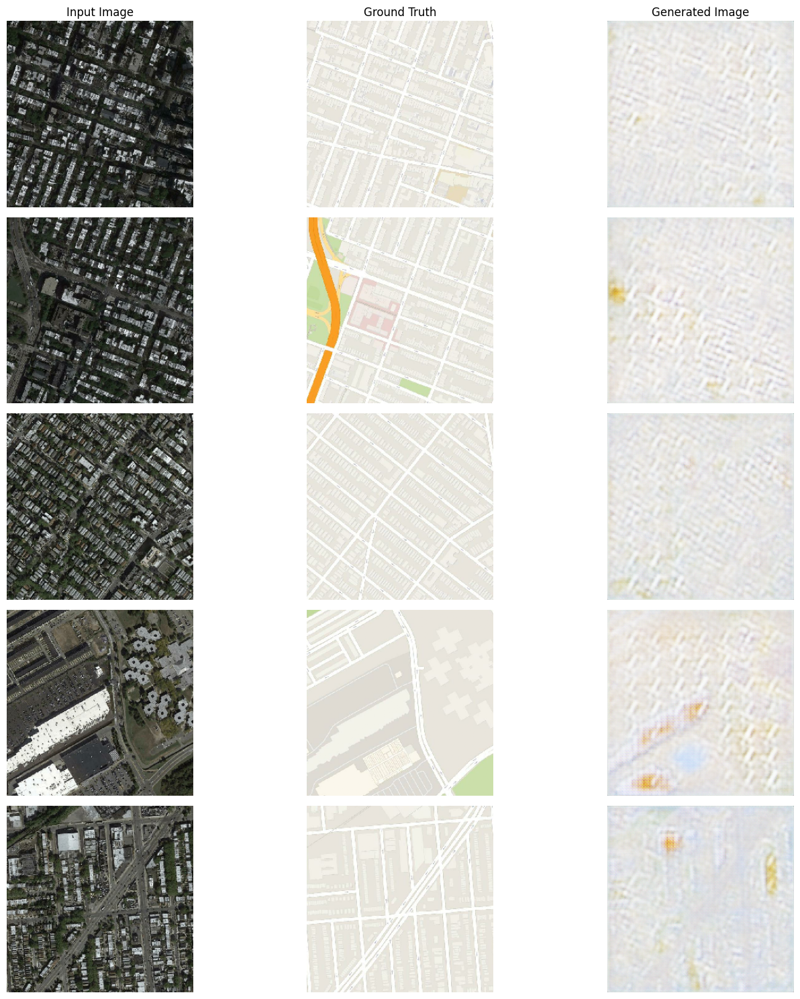

Time taken for epoch 1 is 63.6372 sec

Time taken for epoch 1 is 63.6448 sec

Epoch 2 Batch 0 - Gen Total Loss: 10.1222, Disc Loss: 1.1022
Epoch 2 Batch 100 - Gen Total Loss: 9.4435, Disc Loss: 1.1244
Epoch 2 Batch 200 - Gen Total Loss: 13.9017, Disc Loss: 1.0109
Epoch 2 Batch 300 - Gen Total Loss: 12.9781, Disc Loss: 0.3078
Epoch 2 Batch 400 - Gen Total Loss: 15.0256, Disc Loss: 0.5077
Epoch 2 Batch 500 - Gen Total Loss: 9.9239, Disc Loss: 1.3729
Generated samples after epoch 2:


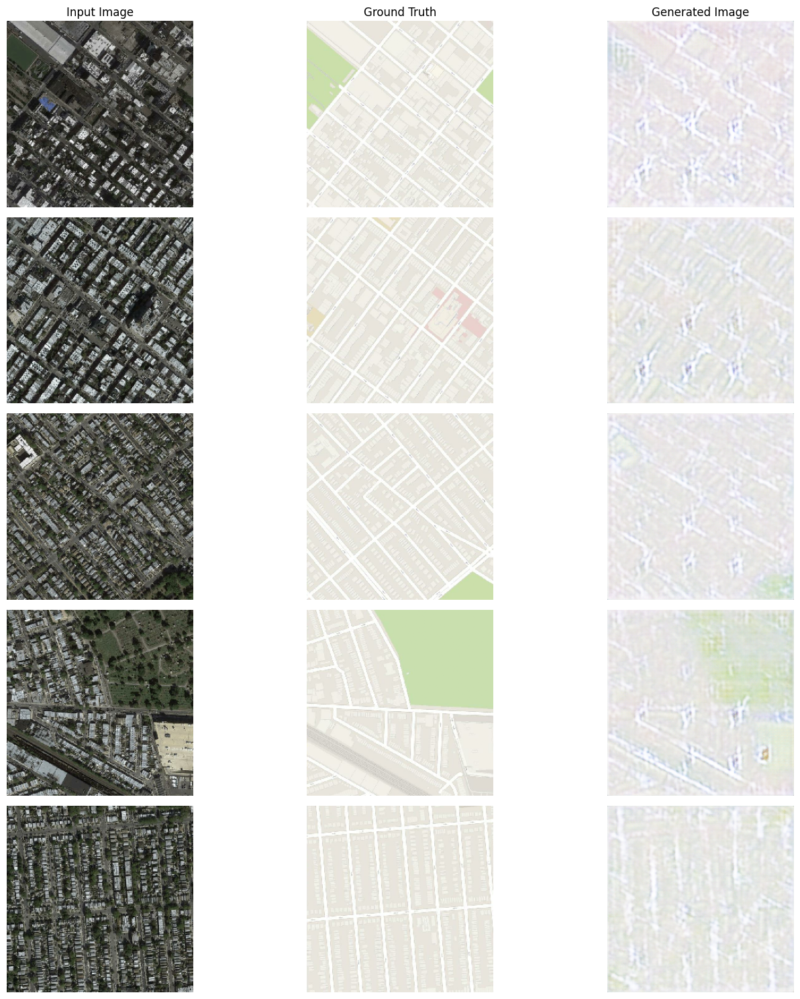

Time taken for epoch 2 is 49.0980 sec

Time taken for epoch 2 is 49.1023 sec

Epoch 3 Batch 0 - Gen Total Loss: 8.9419, Disc Loss: 1.1755
Epoch 3 Batch 100 - Gen Total Loss: 11.0890, Disc Loss: 1.2275
Epoch 3 Batch 200 - Gen Total Loss: 11.1526, Disc Loss: 1.1285
Epoch 3 Batch 300 - Gen Total Loss: 12.3663, Disc Loss: 0.2445
Epoch 3 Batch 400 - Gen Total Loss: 13.7613, Disc Loss: 0.2972
Epoch 3 Batch 500 - Gen Total Loss: 12.6547, Disc Loss: 2.8405
Generated samples after epoch 3:


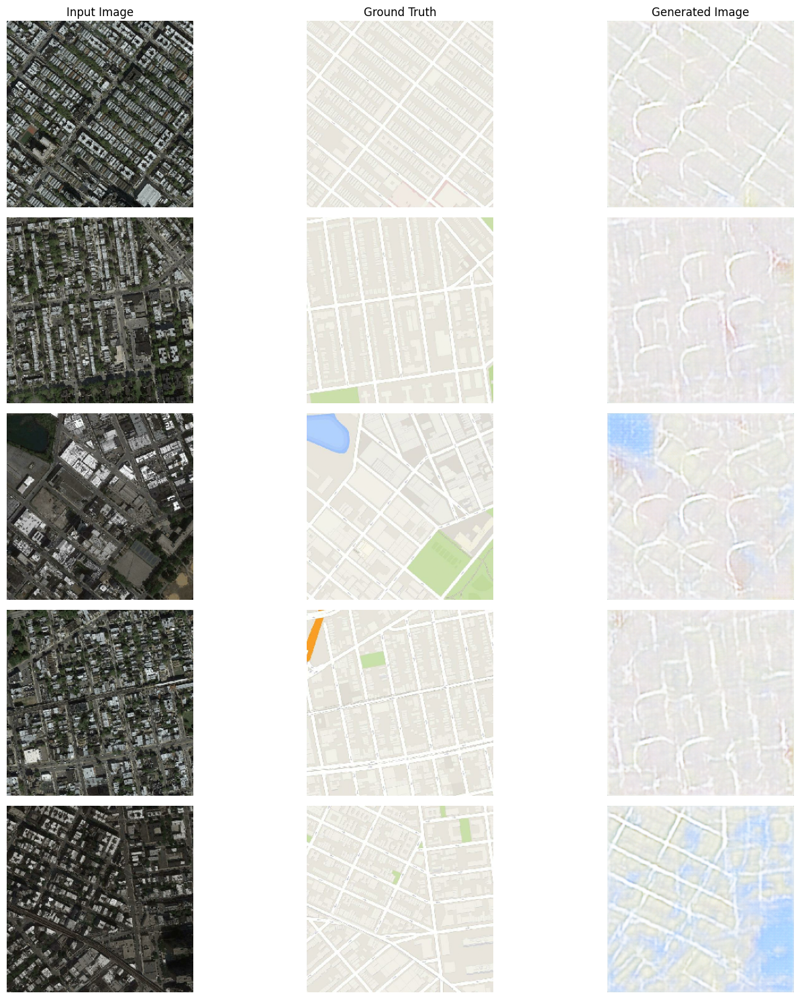

Time taken for epoch 3 is 48.8719 sec

Time taken for epoch 3 is 48.8804 sec

Epoch 4 Batch 0 - Gen Total Loss: 19.5777, Disc Loss: 0.6403
Epoch 4 Batch 100 - Gen Total Loss: 16.6151, Disc Loss: 0.1424
Epoch 4 Batch 200 - Gen Total Loss: 10.3533, Disc Loss: 1.1238
Epoch 4 Batch 300 - Gen Total Loss: 11.0701, Disc Loss: 0.8977
Epoch 4 Batch 400 - Gen Total Loss: 14.0530, Disc Loss: 1.7086
Epoch 4 Batch 500 - Gen Total Loss: 10.2976, Disc Loss: 1.0025
Generated samples after epoch 4:


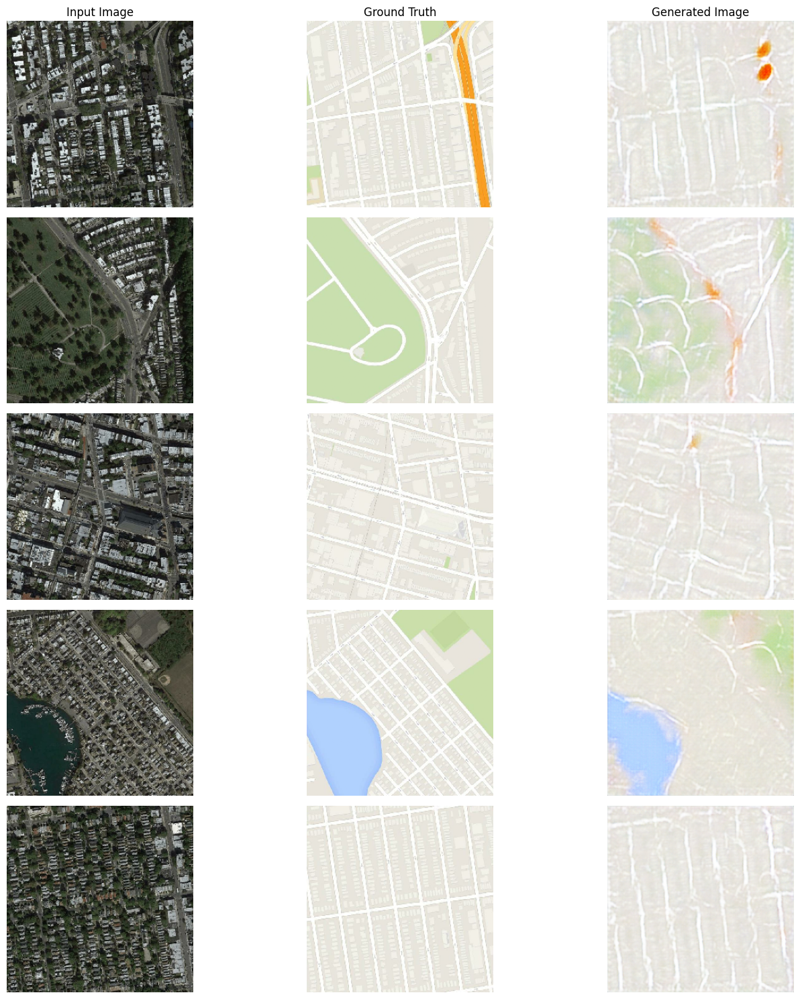

Time taken for epoch 4 is 36.0774 sec

Time taken for epoch 4 is 36.0787 sec

Epoch 5 Batch 0 - Gen Total Loss: 10.2588, Disc Loss: 0.4620
Epoch 5 Batch 100 - Gen Total Loss: 10.1318, Disc Loss: 0.5417
Epoch 5 Batch 200 - Gen Total Loss: 10.1438, Disc Loss: 1.1923
Epoch 5 Batch 300 - Gen Total Loss: 12.8706, Disc Loss: 1.9729
Epoch 5 Batch 400 - Gen Total Loss: 11.7527, Disc Loss: 0.6538
Epoch 5 Batch 500 - Gen Total Loss: 10.9566, Disc Loss: 0.5399
Generated samples after epoch 5:


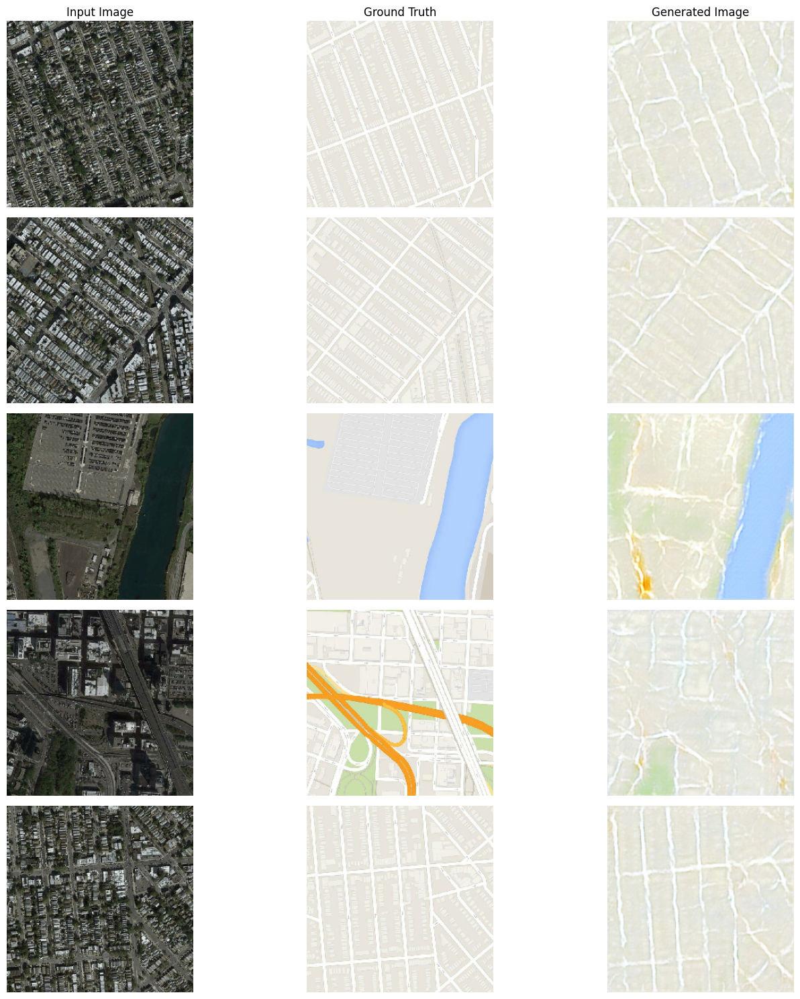

Time taken for epoch 5 is 35.5356 sec

Time taken for epoch 5 is 35.5368 sec

Epoch 6 Batch 0 - Gen Total Loss: 10.3025, Disc Loss: 1.5128
Epoch 6 Batch 100 - Gen Total Loss: 11.4989, Disc Loss: 0.4567
Epoch 6 Batch 200 - Gen Total Loss: 9.1152, Disc Loss: 1.9311
Epoch 6 Batch 300 - Gen Total Loss: 11.6689, Disc Loss: 3.8793
Epoch 6 Batch 400 - Gen Total Loss: 9.9957, Disc Loss: 0.6273
Epoch 6 Batch 500 - Gen Total Loss: 16.6501, Disc Loss: 0.5714
Generated samples after epoch 6:


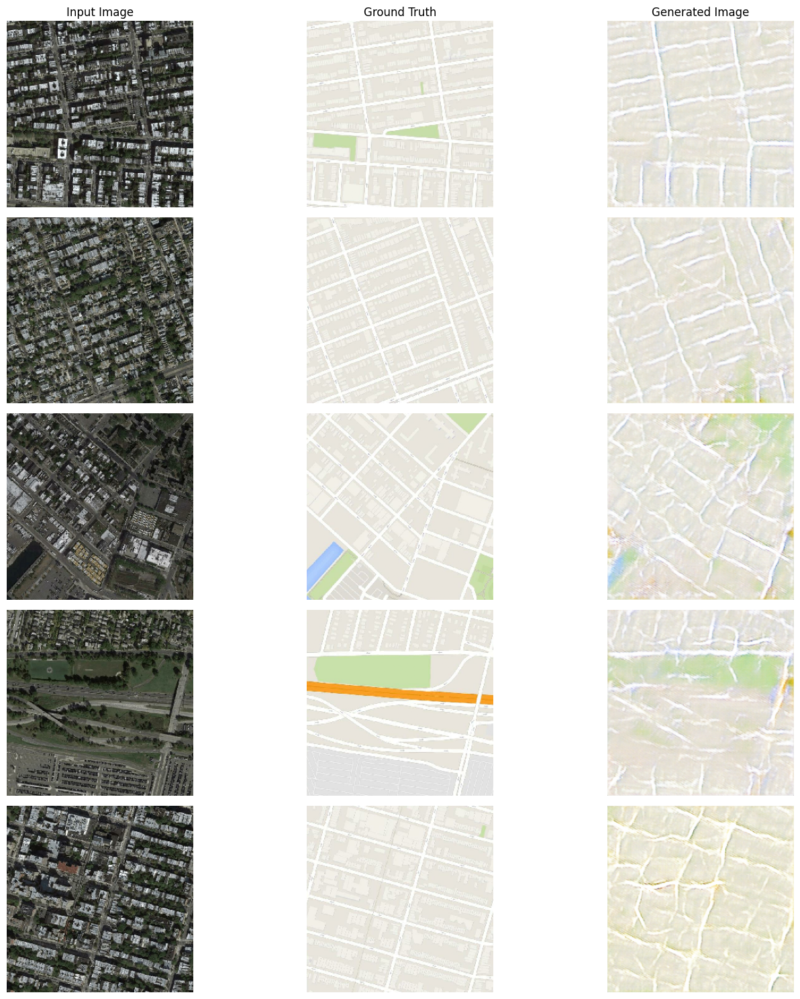

Time taken for epoch 6 is 36.5872 sec

Time taken for epoch 6 is 36.5885 sec

Epoch 7 Batch 0 - Gen Total Loss: 9.2376, Disc Loss: 0.9238
Epoch 7 Batch 100 - Gen Total Loss: 15.1117, Disc Loss: 1.9181
Epoch 7 Batch 200 - Gen Total Loss: 10.3141, Disc Loss: 0.5002
Epoch 7 Batch 300 - Gen Total Loss: 12.0553, Disc Loss: 1.8083
Epoch 7 Batch 400 - Gen Total Loss: 8.5991, Disc Loss: 1.2259
Epoch 7 Batch 500 - Gen Total Loss: 10.2801, Disc Loss: 0.8466
Generated samples after epoch 7:


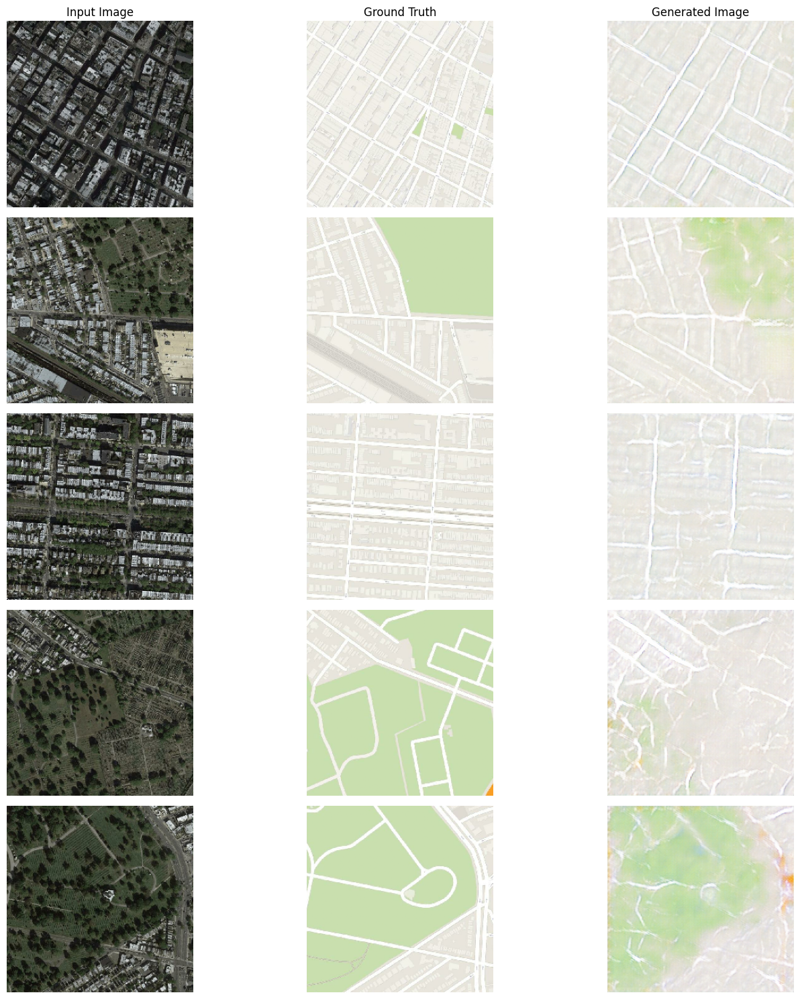

Time taken for epoch 7 is 37.0661 sec

Time taken for epoch 7 is 37.0676 sec

Epoch 8 Batch 0 - Gen Total Loss: 11.3847, Disc Loss: 0.4337
Epoch 8 Batch 100 - Gen Total Loss: 16.6789, Disc Loss: 0.8243
Epoch 8 Batch 200 - Gen Total Loss: 10.0423, Disc Loss: 0.3874
Epoch 8 Batch 300 - Gen Total Loss: 8.7773, Disc Loss: 0.7847
Epoch 8 Batch 400 - Gen Total Loss: 12.3597, Disc Loss: 0.2990
Epoch 8 Batch 500 - Gen Total Loss: 13.9943, Disc Loss: 0.3174
Generated samples after epoch 8:


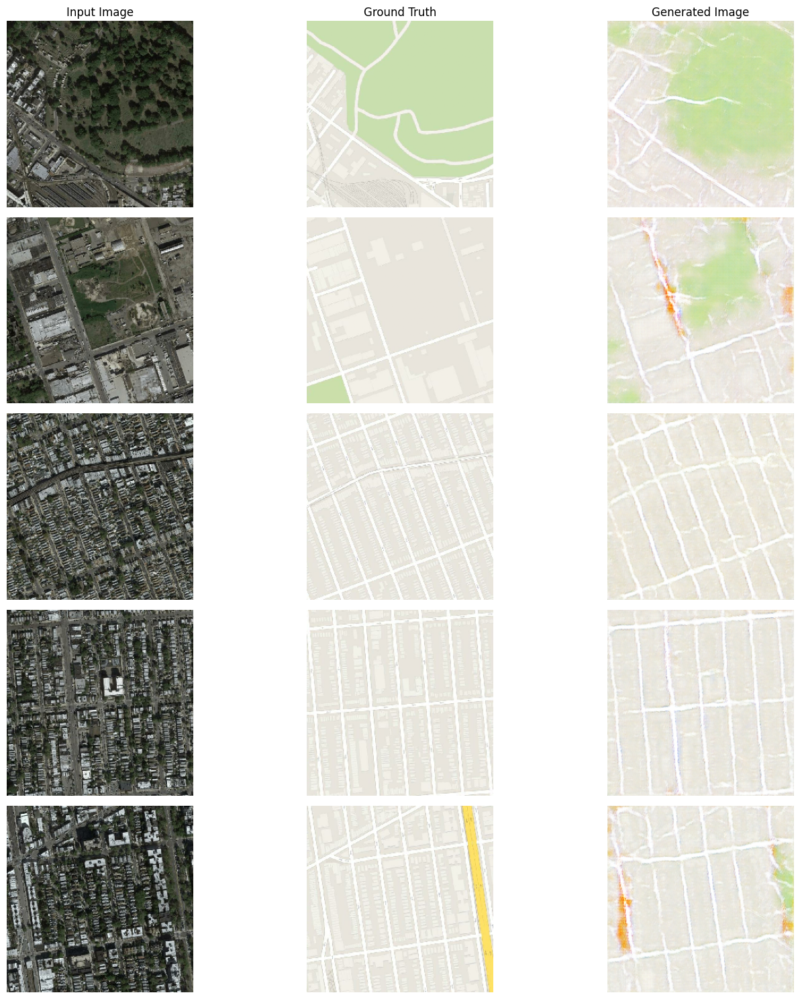

Time taken for epoch 8 is 37.4938 sec

Time taken for epoch 8 is 37.4961 sec

Epoch 9 Batch 0 - Gen Total Loss: 13.1449, Disc Loss: 1.4136
Epoch 9 Batch 100 - Gen Total Loss: 7.1083, Disc Loss: 0.9296
Epoch 9 Batch 200 - Gen Total Loss: 7.8153, Disc Loss: 0.9712
Epoch 9 Batch 300 - Gen Total Loss: 8.9030, Disc Loss: 1.0782
Epoch 9 Batch 400 - Gen Total Loss: 17.3076, Disc Loss: 0.6020
Epoch 9 Batch 500 - Gen Total Loss: 8.7691, Disc Loss: 0.8663
Generated samples after epoch 9:


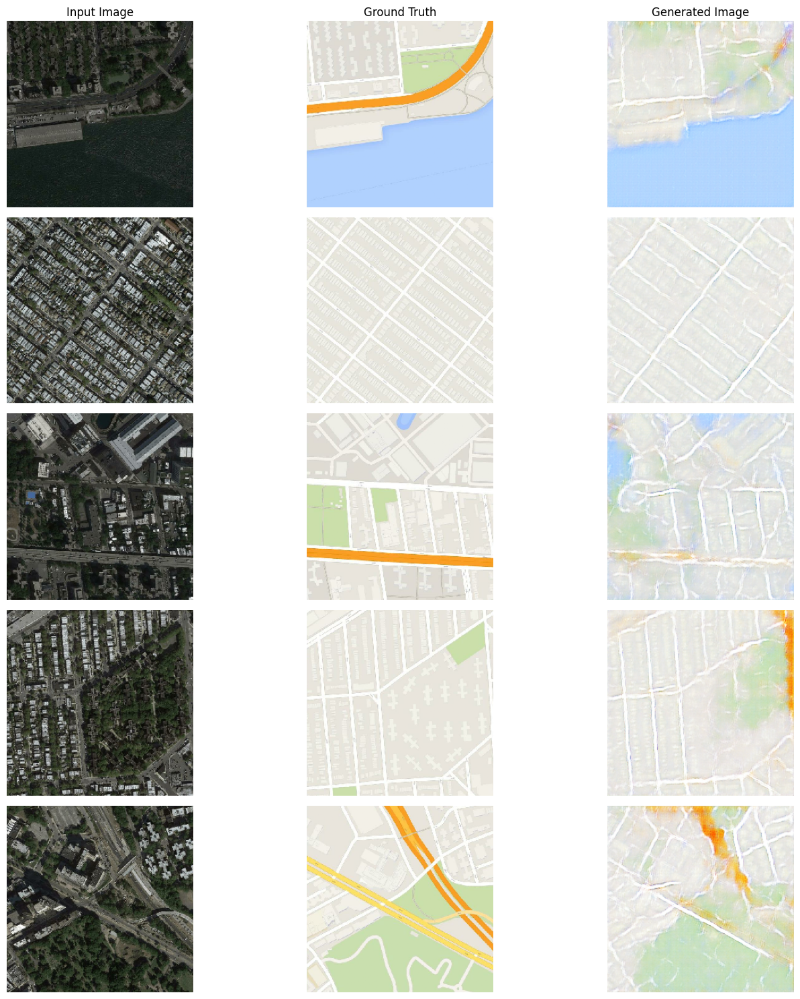

Time taken for epoch 9 is 37.5381 sec

Time taken for epoch 9 is 37.5400 sec

Epoch 10 Batch 0 - Gen Total Loss: 11.5511, Disc Loss: 1.0857
Epoch 10 Batch 100 - Gen Total Loss: 10.5100, Disc Loss: 0.4877
Epoch 10 Batch 200 - Gen Total Loss: 10.1828, Disc Loss: 0.4428
Epoch 10 Batch 300 - Gen Total Loss: 9.3740, Disc Loss: 1.2376
Epoch 10 Batch 400 - Gen Total Loss: 9.8359, Disc Loss: 0.4362
Epoch 10 Batch 500 - Gen Total Loss: 8.7550, Disc Loss: 0.7727
Generated samples after epoch 10:


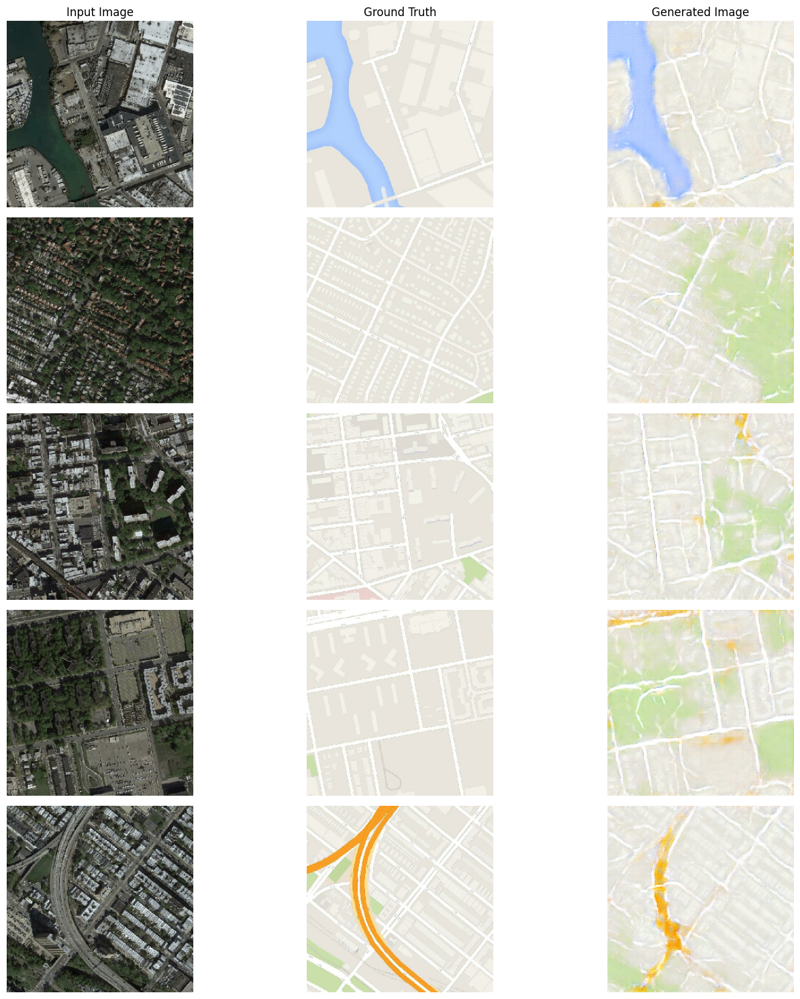

Time taken for epoch 10 is 37.6359 sec

Time taken for epoch 10 is 37.6379 sec



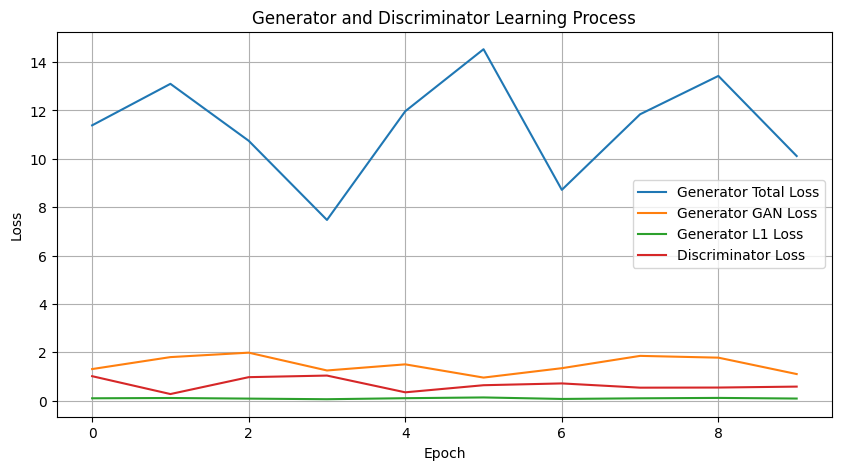

In [13]:
train_dataset, test_dataset = load_train_test_datasets(path_train, path_val)

fit(train_dataset, test_dataset, EPOCHS, generator, discriminator)
